# YOLOE_test.ipynb

This workbook evaluates the YOLOE model (yoloe-11l-seg.pt) model for automatic detection of coconut trees in 10 images from iNaturalist 5 images from Jackson5.

- inputs
    - example_images folder
    - yoloe-11l-seg.pt
    - mobileclip_blt.ts
- outputs
    - annotated_images folder
    - image_problems.csv
    - segmentation_problems.csv

[1269436.jpg](annotated_images/coconut_tree/1269436.jpg)

In [1]:
!uv add ultralytics supervision ipywidgets icecream
!uv add pandas

Resolved 133 packages in 0.50ms
Audited 130 packages in 1ms
Resolved 133 packages in 0.55ms
Audited 130 packages in 1ms


In [2]:
from ultralytics import YOLOE
import supervision as sv
import glob
import cv2
from icecream import ic
import matplotlib.pyplot as plt
import os
from IPython.display import display, Markdown
import numpy as np
import pandas as pd

## Example image set

The `examples` dictionary in the following cell defines how the example image set is stored. 
- 3 subsets:
    - `coconut tree`: images of coconut palms downloaded from iNaturalist
    - `coconut`: images of coconut seeds downloaded from iNaturalist
    - `j5`: images illustrating 5 damage levels copied from Jackson, Trevor A. 2019. Rhinoceros beetle damage. Workshop with Kokonas Indastri Koporesen (KIK). Madang, PNG. May 20, 2019.
- `name`: short name for subset
- `dirpath`: path to a data directory 
- `filenames`: list of file names in the data directory

Here's how to move through the data structure:
````python
for subset in examples:
    print(subset)
    dirpath = examples[subset]['dirpath']
    for filename in examples[subset]['filenames']:
        filepath = f'{dirpath}/{filename}'
        print(filepath)
````

## Analysis

Examination of annotated images, plotted at the end of this notebook, show some problems
which are listed in the following table.

## Moving forward

Best solution may be to suppress detection of palm trees which are occluded at the left, right and top of images by removing polygons prior to retraining.
These images should be retained in the training dataset so that the model learns to disregard coconut palm trees occluded by the left, right and top edges. 
[Yolo detect object at edge of image \#6354](https://github.com/ultralytics/ultralytics/issues/6354)

In [3]:
def keep_largest_component_opencv(mask):
    """
    Keeps only the largest connected component in a binary mask using OpenCV.

    Args:
        mask (np.ndarray): A binary input mask (0s and 255s).

    Returns:
        np.ndarray: A new mask containing only the largest connected component (0s and 255s).
    """
    # Ensure mask is in the correct format (uint8 binary)
    if mask.dtype != np.uint8:
        mask = (mask * 255).astype(np.uint8)

    # Find contours
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if not contours:
        return np.zeros_like(mask, dtype=np.uint8)

    # Find the largest contour by area
    largest_contour = max(contours, key=cv2.contourArea)

    # Create a new blank mask and draw only the largest contour
    new_mask = np.zeros_like(mask, dtype=np.uint8)
    cv2.drawContours(new_mask, [largest_contour], -1, 255, cv2.FILLED)
    
    return new_mask

# Example Usage:
# Assume 'yolo_mask' is your input binary mask (e.g., a NumPy array of 0s and 255s)
# yolo_mask = ... 
# result_mask = keep_largest_component_opencv(yolo_mask)


In [ ]:
def find_large_files(start_path, min_size_mb):
    """
    Finds files larger than a specified size in a directory tree.

    Args:
        start_path (str): The root directory to start the search from.
        min_size_mb (int): The minimum file size in megabytes.

    Returns:
        list: A list of paths to files larger than min_size_mb.
    """
    large_files = []
    min_size_bytes = min_size_mb * 1024 * 1024  # Convert MB to bytes

    for dirpath, dirnames, filenames in os.walk(start_path):
        for filename in filenames:
            filepath = os.path.join(dirpath, filename)
            try:
                if os.path.getsize(filepath) > min_size_bytes:
                    large_files.append(filepath)
            except OSError as e:
                # Handle cases where file might be inaccessible (e.g., permissions)
                print(f"Error accessing file {filepath}: {e}")
    return large_files

# large_file_list = find_large_files('../YOLOE', 50)
# if len(large_file_list) > 0:
#     print('WARNING: The following files are larger than 50 MB were found:')
#     for large_file in large_file_list:
#         print(large_file)
#     print('Consider adding these to .gitignore to prevent GitHub problems.')

../YOLOE/mobileclip_blt.ts
../YOLOE/yoloe-11l-seg.pt
Consider adding these to .gitignore to prevent GitHub problems.


# Main

In [4]:
# Initialize a YOLOE segmentation model
# Load the YOLOE segmentation model
# If the model is not found in the current directory, it will be downloaded automatically.
model = YOLOE("yoloe-11l-seg.pt")

In [5]:
# Set text prompt to detect "coconut tree". 
# This only needs to be done once after the YOLOE segmentation model is loaded.
# Text prompting uses a CLIP model.
# If the CLIP model is not found in the current directory, it will be downloaded automatically.
names = ["coconut tree"]
model.set_classes(names, model.get_text_pe(names))

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut


# coconut | 14162815.jpg

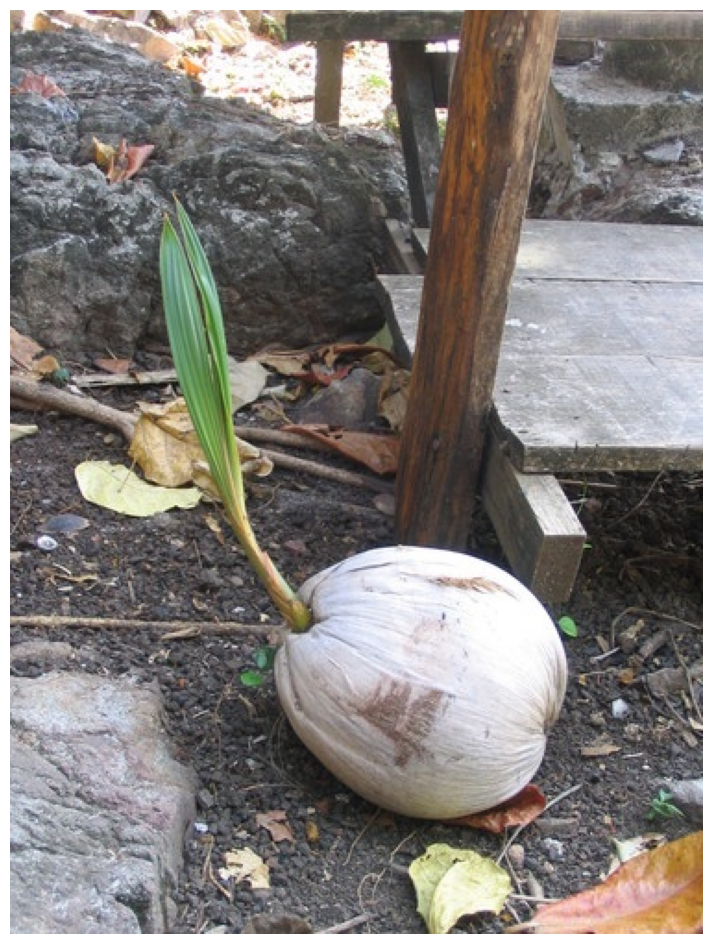

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut


# coconut | 17833889.jpg

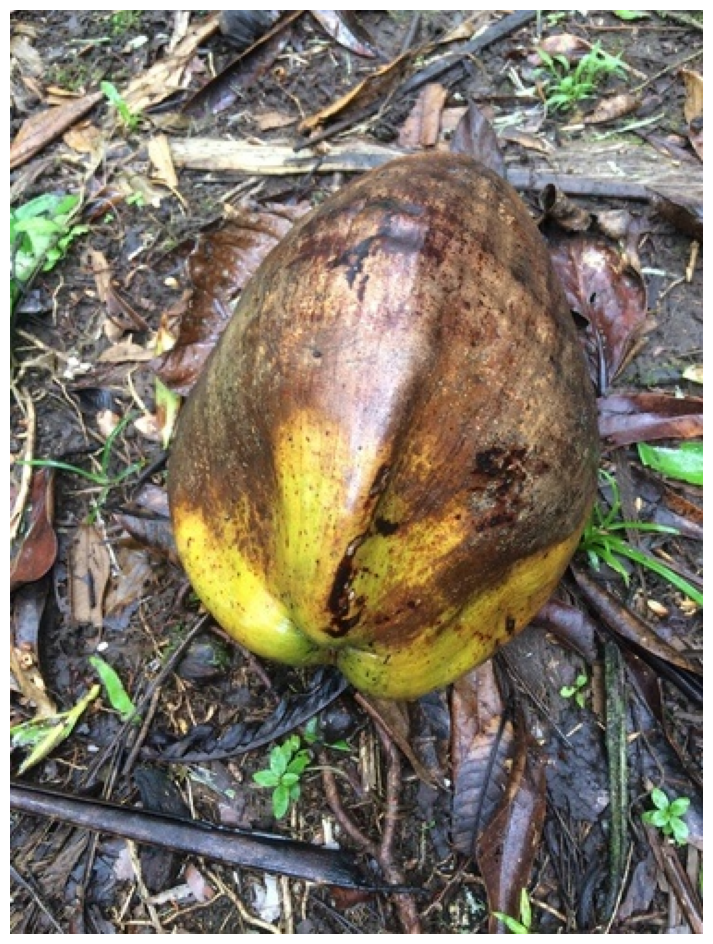

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut


# coconut | 1838130.jpg

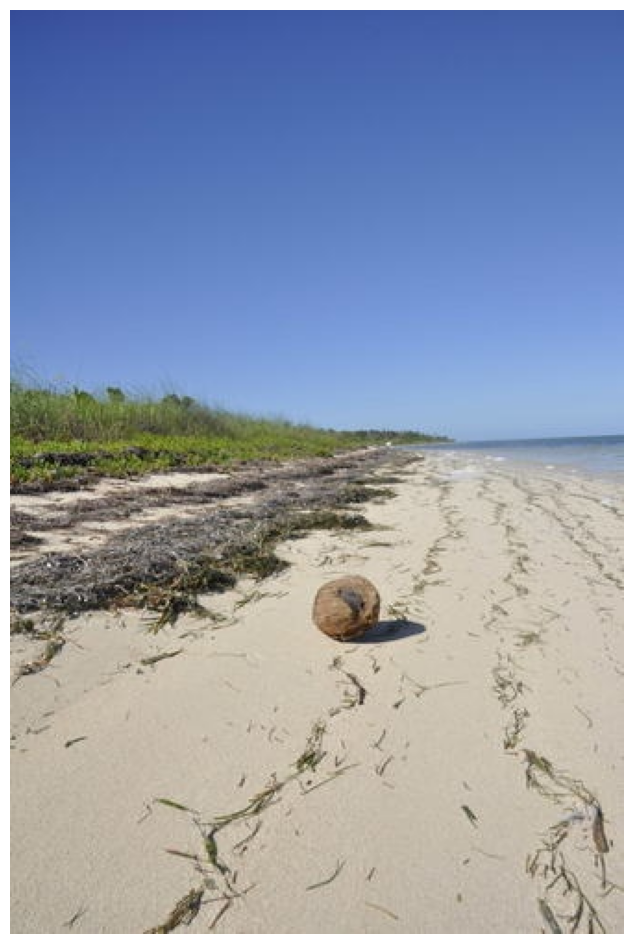

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut


# coconut | 3860847.jpg

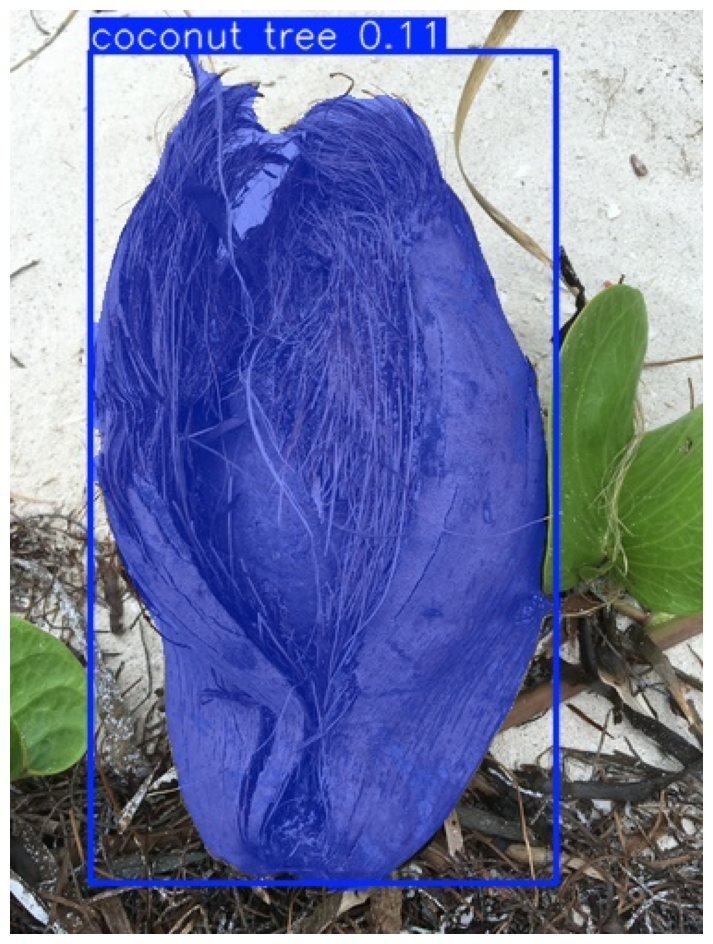

ic| mask_filename: 'annotated_images/coconut/3860847-0.jpg'


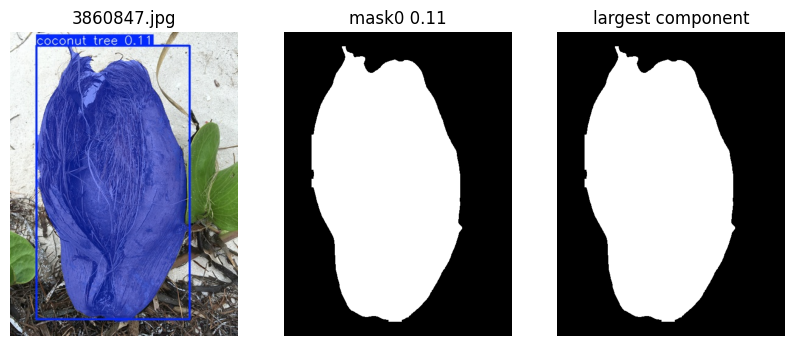

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut


# coconut | 9255115.jpg

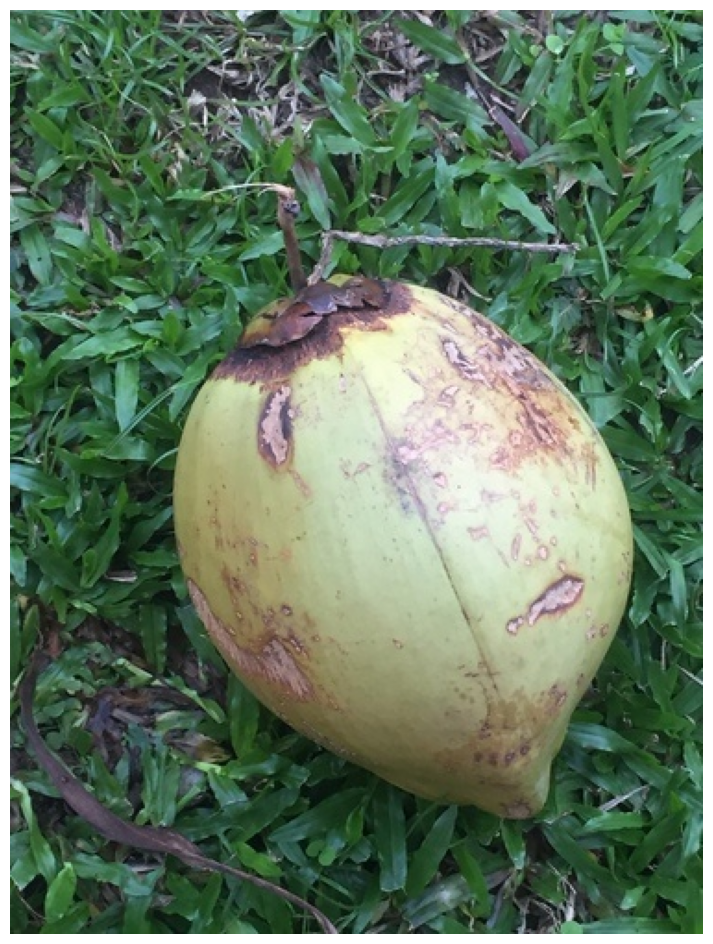

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut_tree


# coconut_tree | 1269436.jpg

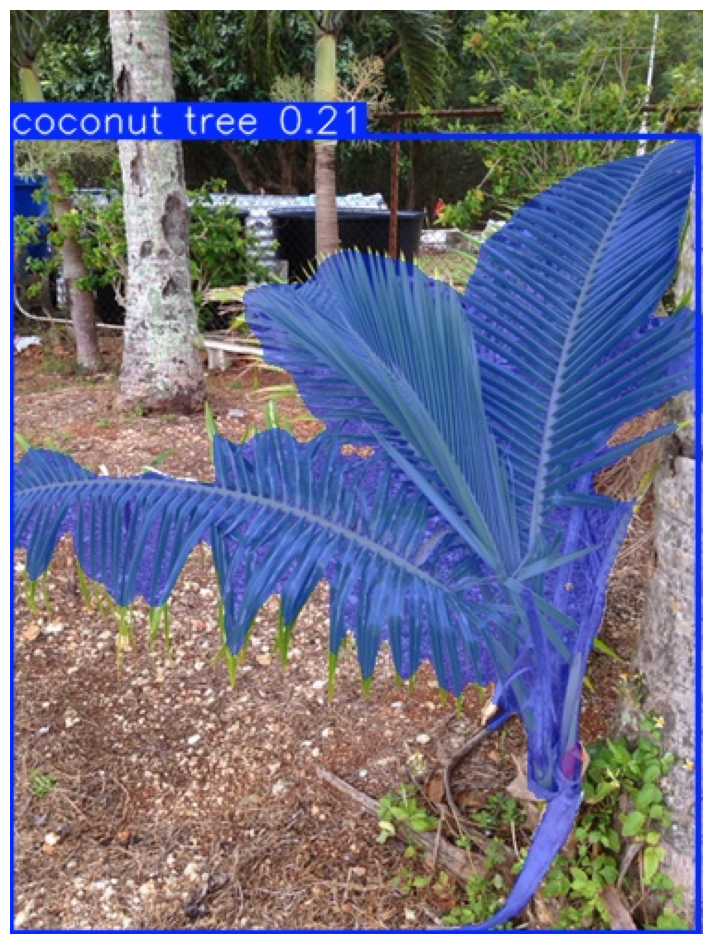

ic| mask_filename: 'annotated_images/coconut_tree/1269436-0.jpg'


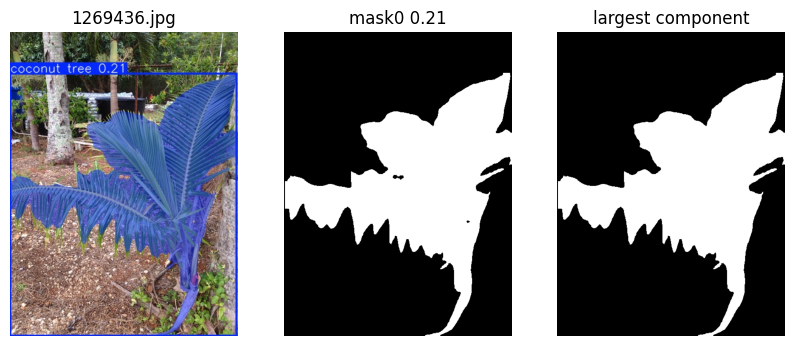

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut_tree


# coconut_tree | 1269637.jpg

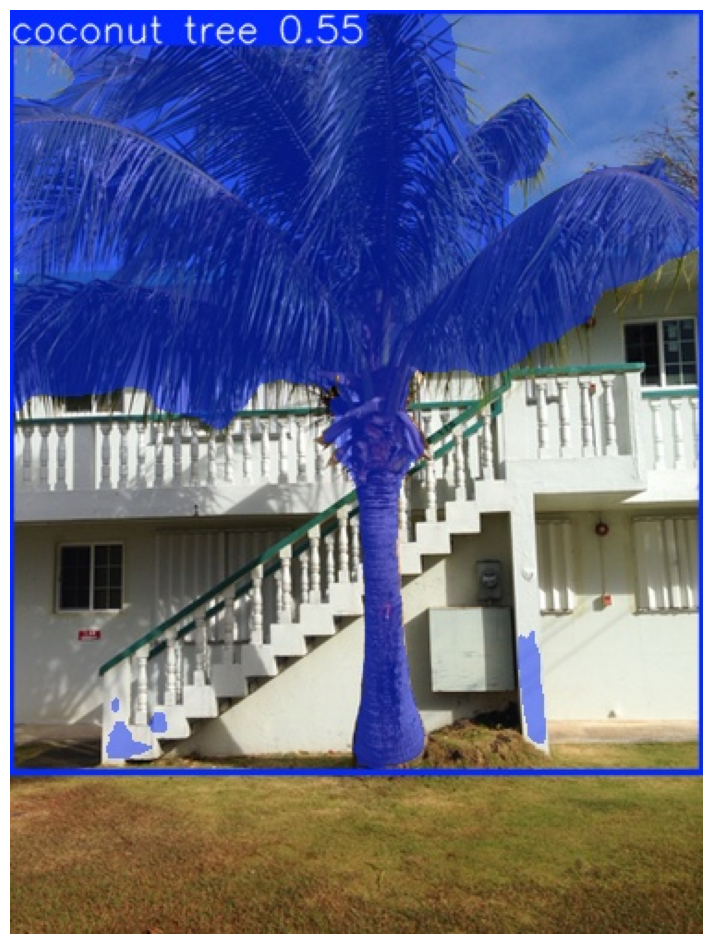

ic| mask_filename: 'annotated_images/coconut_tree/1269637-0.jpg'


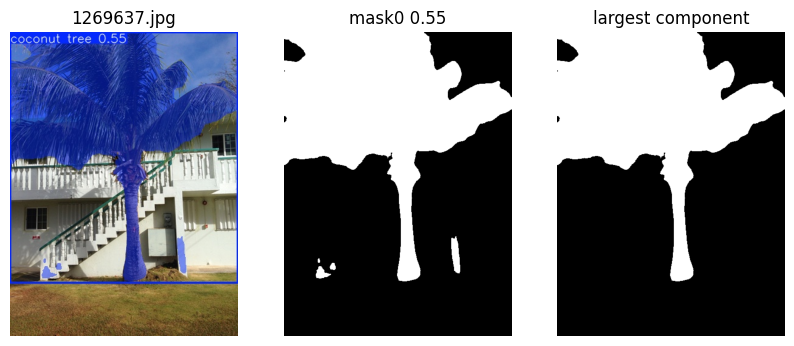

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut_tree


# coconut_tree | 1270736.jpg

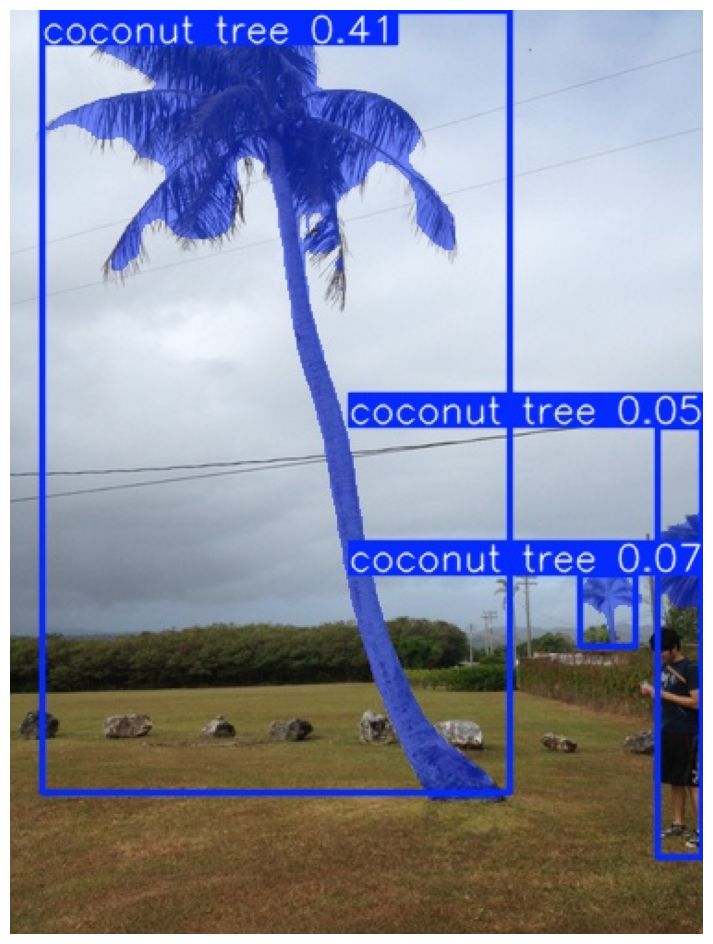

ic| mask_filename: 'annotated_images/coconut_tree/1270736-0.jpg'


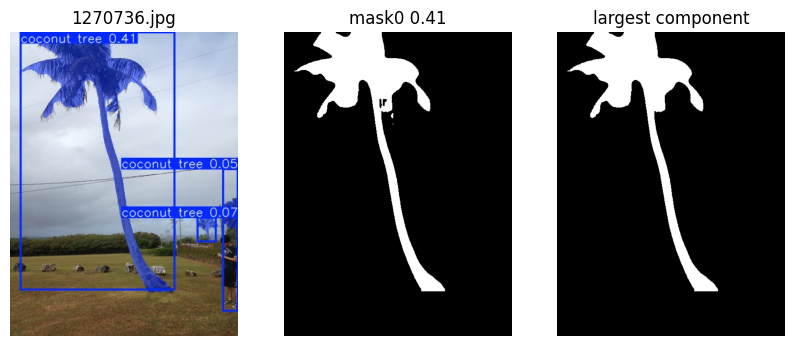

ic| mask_filename: 'annotated_images/coconut_tree/1270736-1.jpg'


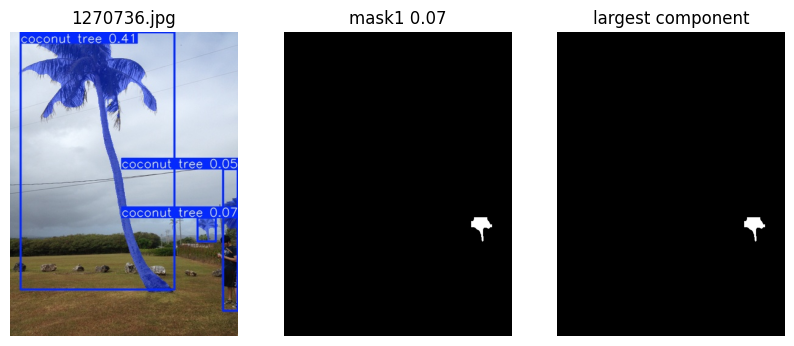

ic| mask_filename: 'annotated_images/coconut_tree/1270736-2.jpg'


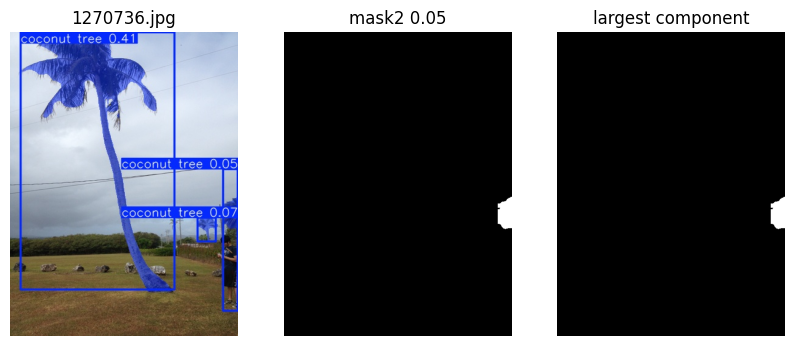

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut_tree


# coconut_tree | 1271795.jpg

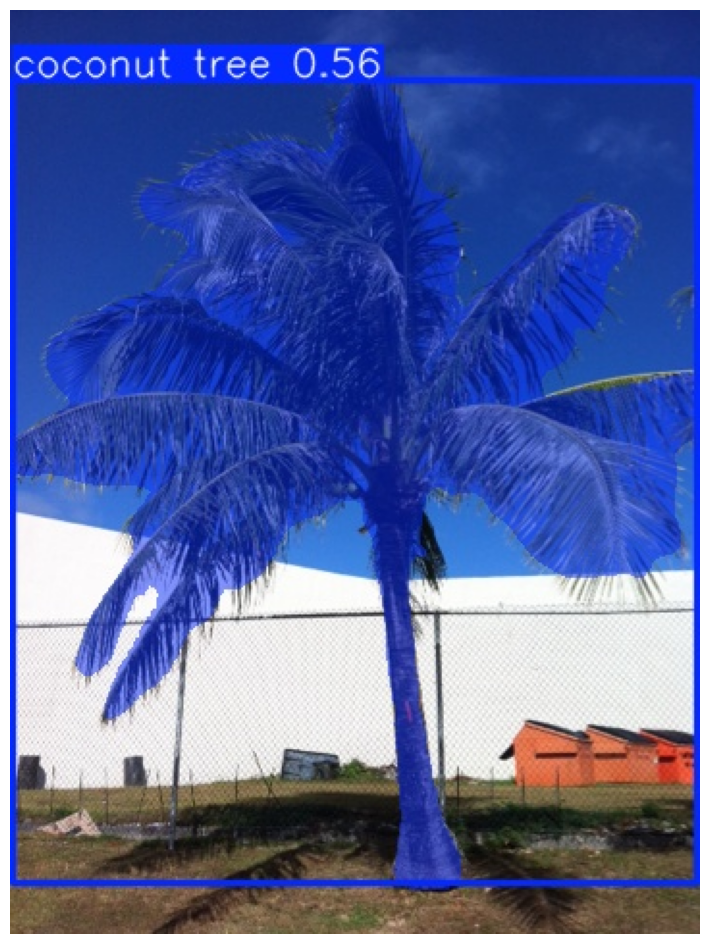

ic| mask_filename: 'annotated_images/coconut_tree/1271795-0.jpg'


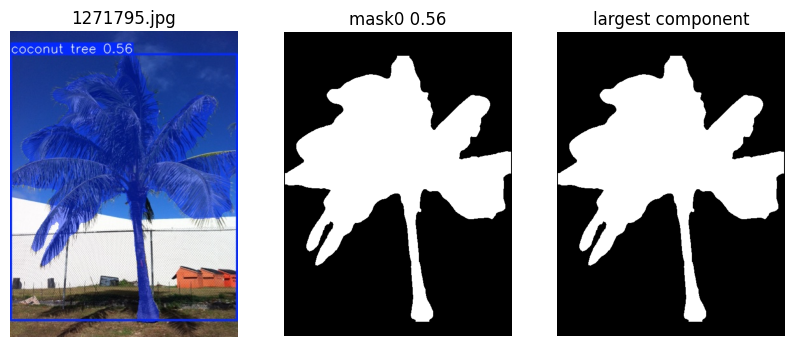

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/coconut_tree


# coconut_tree | 1276183.jpg

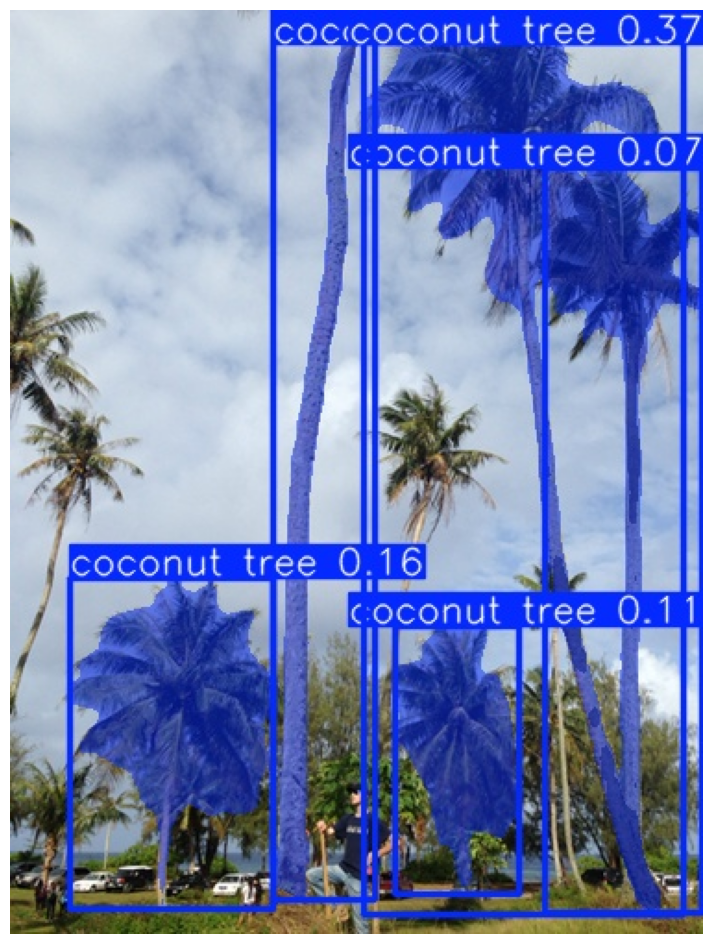

ic| mask_filename: 'annotated_images/coconut_tree/1276183-0.jpg'


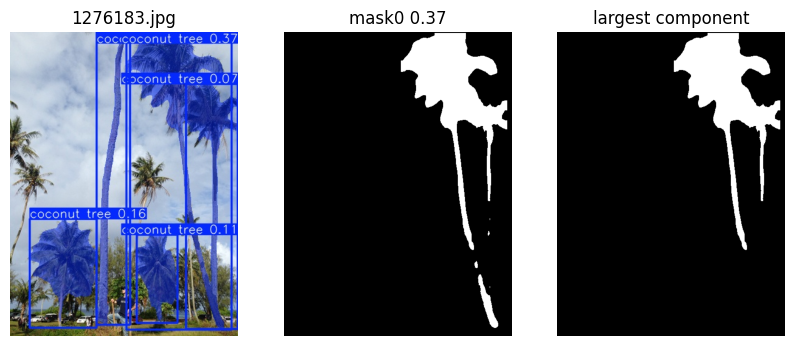

ic| mask_filename: 'annotated_images/coconut_tree/1276183-1.jpg'


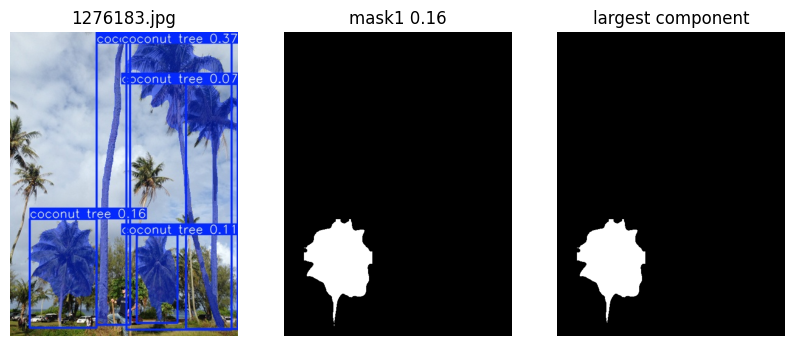

ic| mask_filename: 'annotated_images/coconut_tree/1276183-2.jpg'


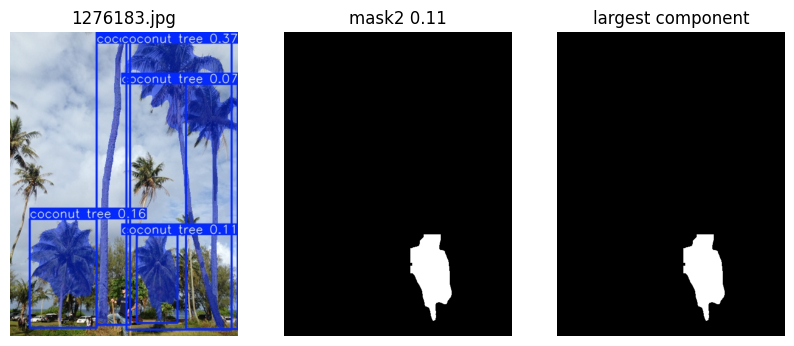

ic| mask_filename: 'annotated_images/coconut_tree/1276183-3.jpg'


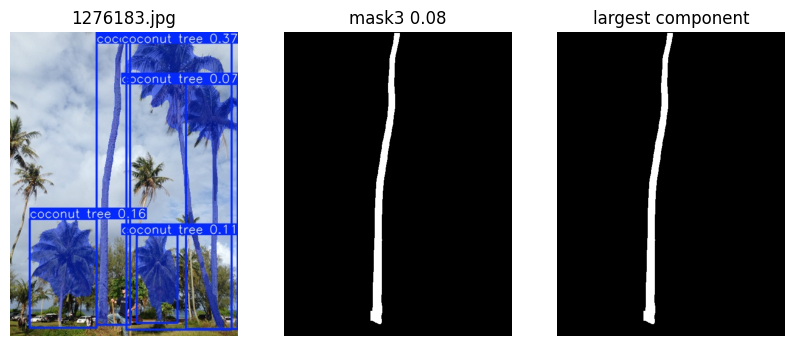

ic| mask_filename: 'annotated_images/coconut_tree/1276183-4.jpg'


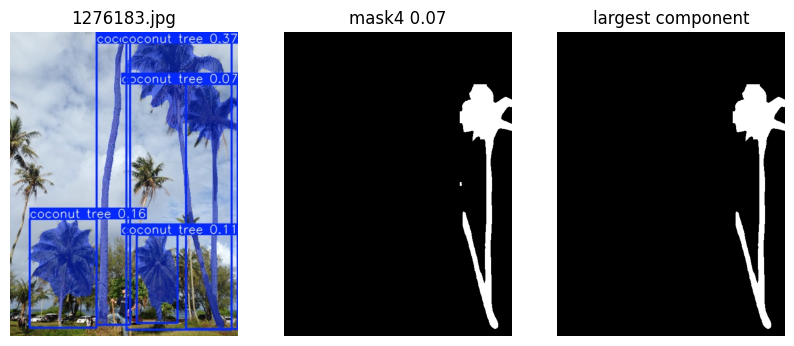

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/j5


# j5 | j5index0.png

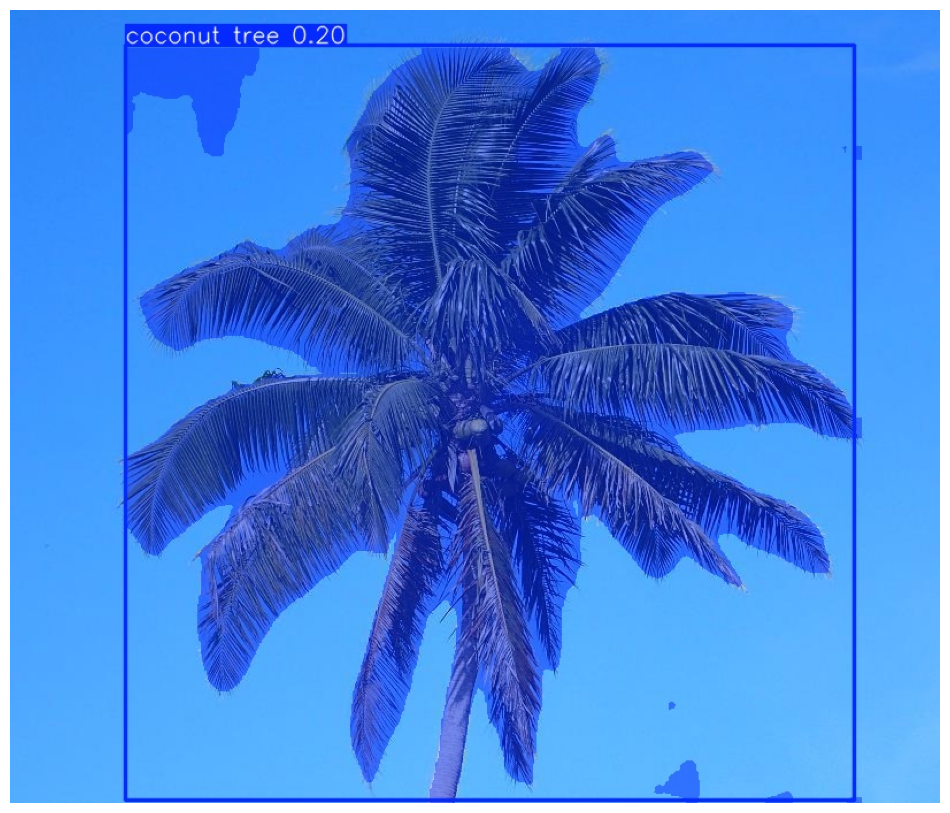

ic| mask_filename: 'annotated_images/j5/j5index0-0.jpg'


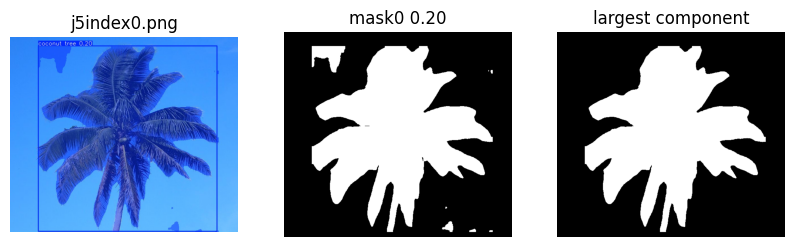

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/j5


# j5 | j5index1.png

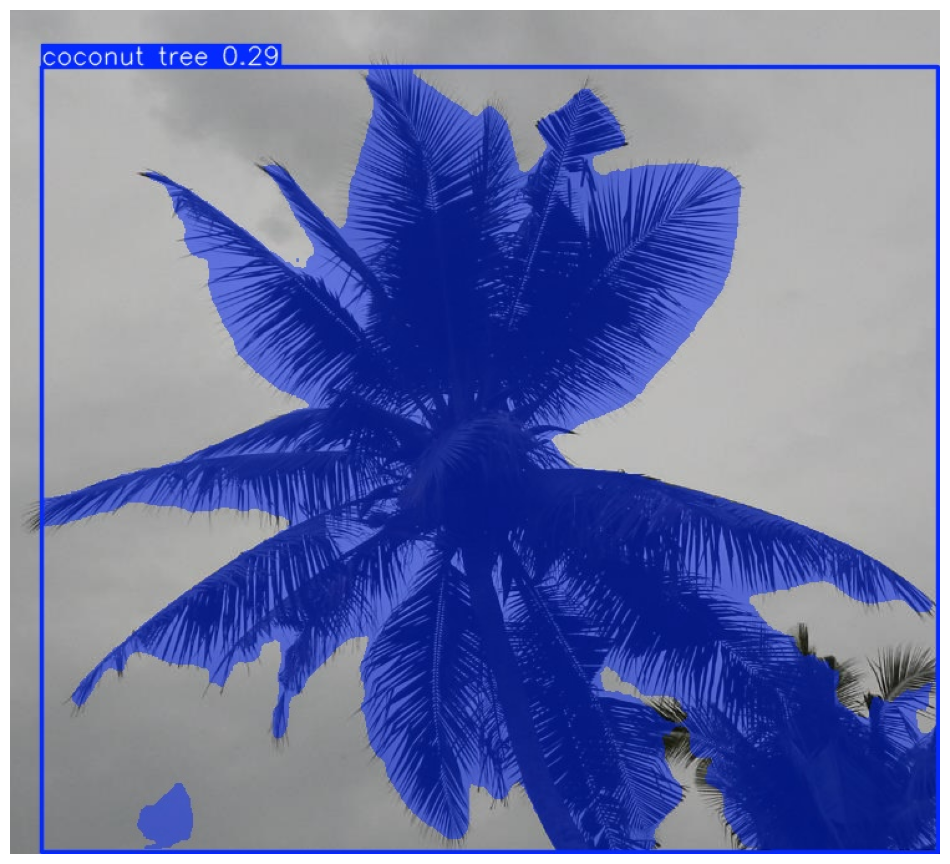

ic| mask_filename: 'annotated_images/j5/j5index1-0.jpg'


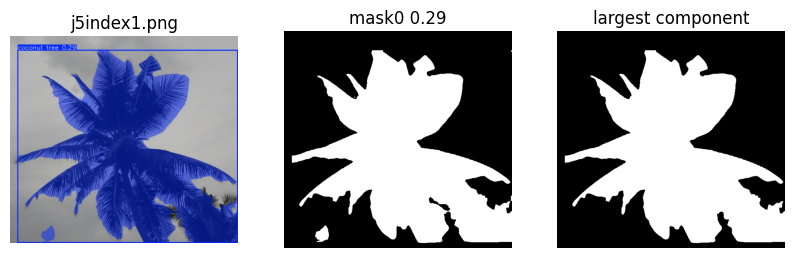

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/j5


# j5 | j5index2.png

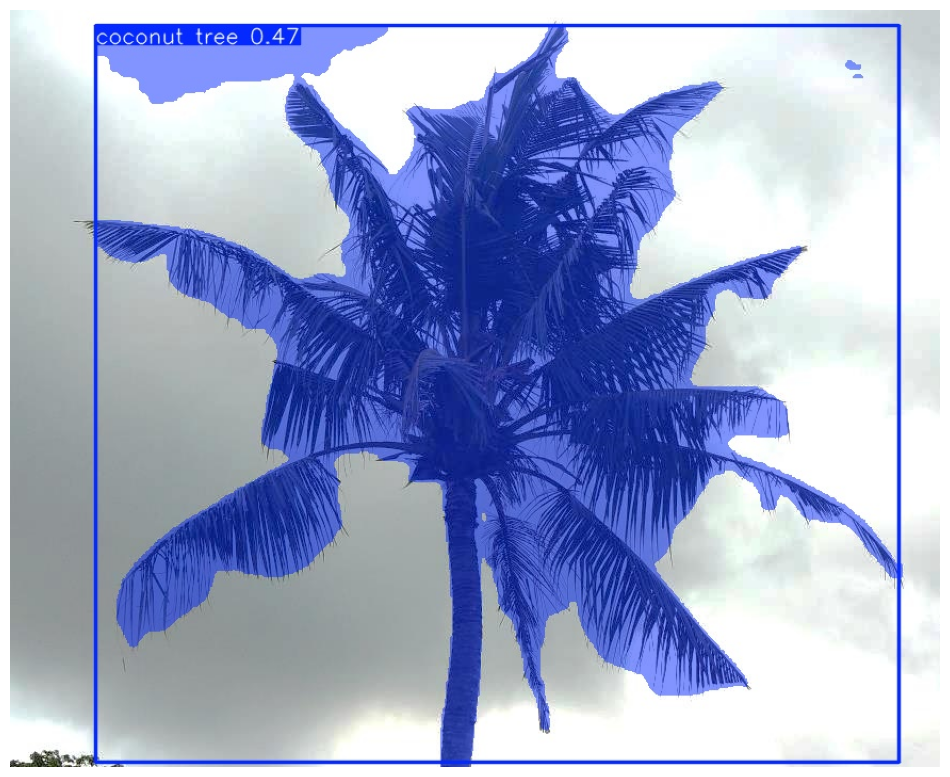

ic| mask_filename: 'annotated_images/j5/j5index2-0.jpg'


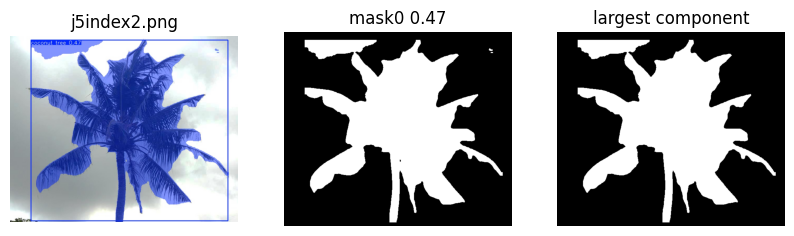

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/j5


# j5 | j5index3.png

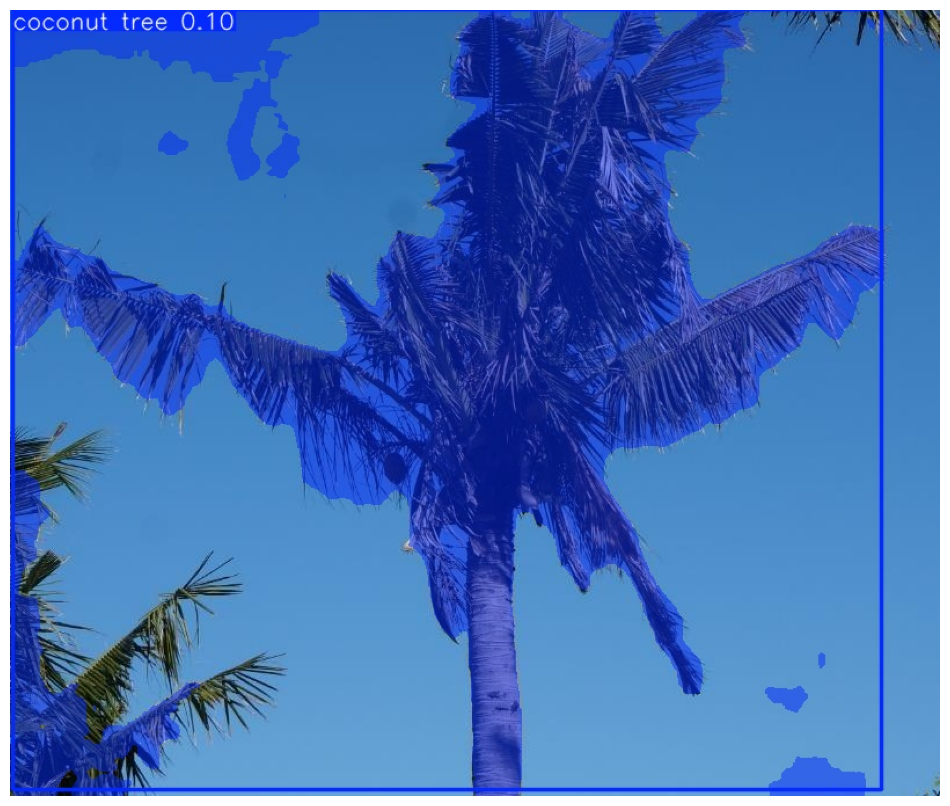

ic| mask_filename: 'annotated_images/j5/j5index3-0.jpg'


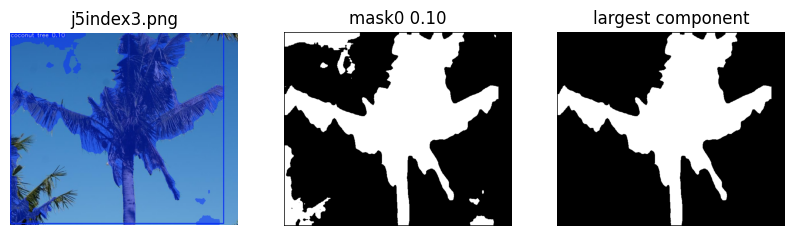

Results saved to /home/aubrey/Desktop/jbook/YOLOE/annotated_images/j5


# j5 | j5index4.png

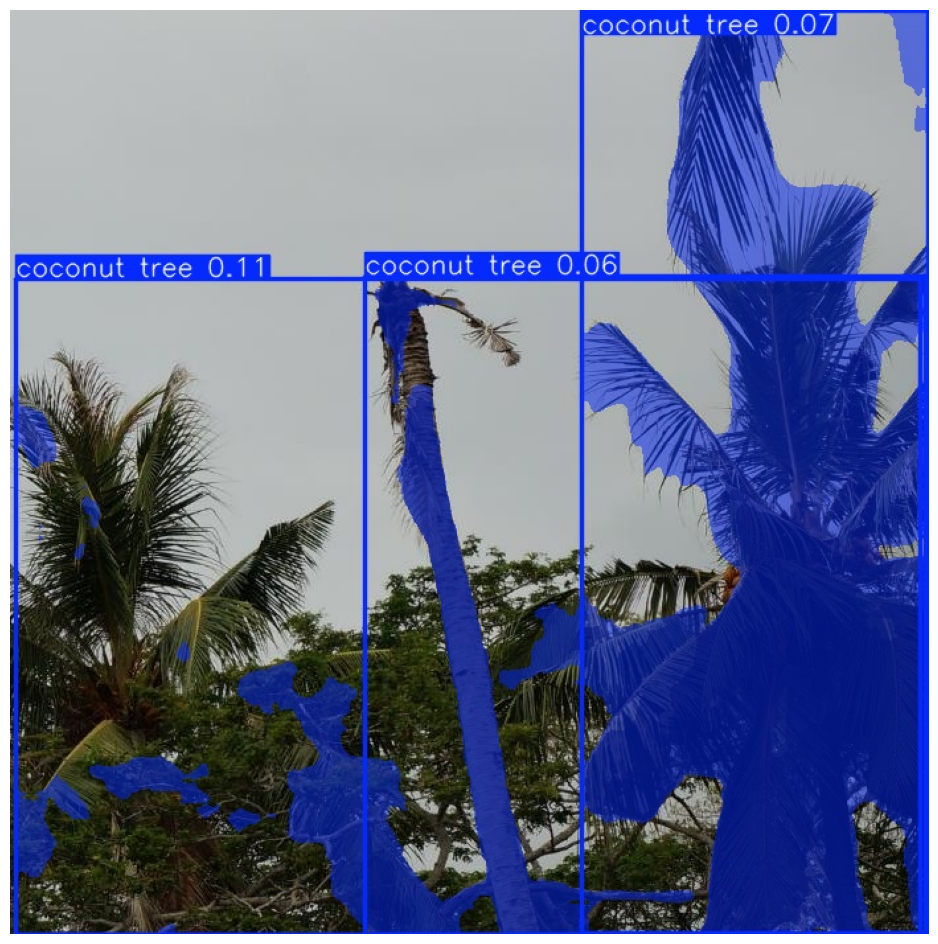

ic| mask_filename: 'annotated_images/j5/j5index4-0.jpg'


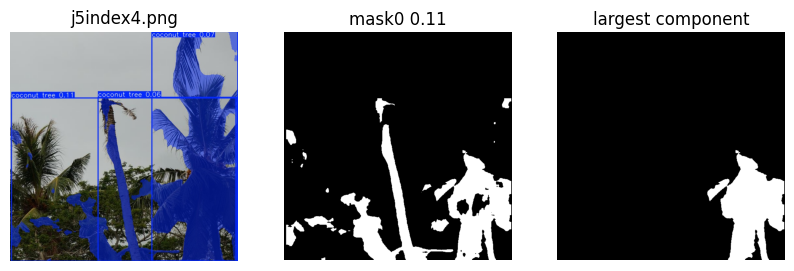

ic| mask_filename: 'annotated_images/j5/j5index4-1.jpg'


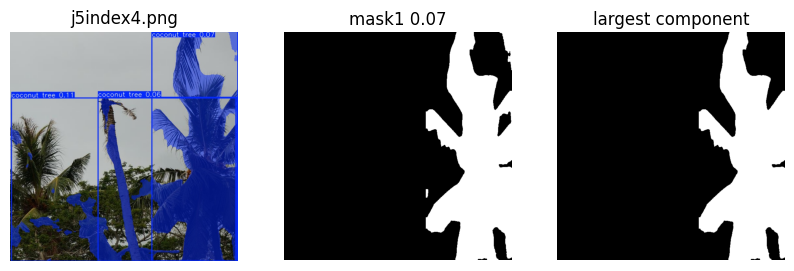

ic| mask_filename: 'annotated_images/j5/j5index4-2.jpg'


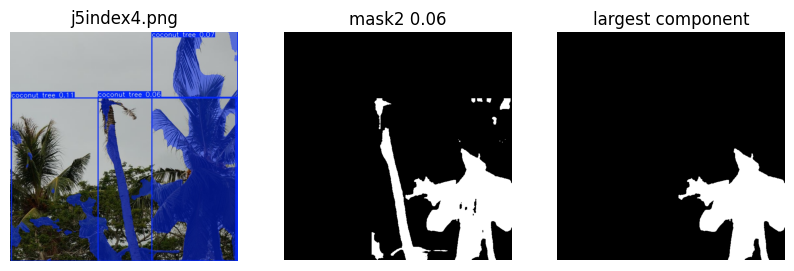

In [6]:
for filepath in sorted(glob.glob('example_images/**/*')):
    subset = filepath.split('/')[1]
    filename = filepath.split('/')[-1]
    
    # detect and segment objects in the image using YOLOE and save annotated images
    project = 'annotated_images'
    results = model.predict(filepath, project=project, name=subset, exist_ok=True, conf=0.05, verbose=False, save=True) 
    annotated_image_path = f'{project}/{subset}/{filename.replace(".png", ".jpg")}'
    annotated_image = cv2.imread(annotated_image_path) 
    
    # plot annotated image 
    title = f'# {subset} | {filename}'
    display(Markdown(title))
    sv.plot_image(annotated_image)

    # for images in which coconut trees were detected, create and save an image for each mask
    for result in results:        
        if result.masks is not None:
            for mask_num, mask in enumerate(result.masks):
                images = []
                titles = []
                annotated_image = cv2.imread(annotated_image_path) 

                if annotated_image is not None:
                    images.append(annotated_image)
                    titles.append(filename)

                # convert mask from tensor to binary image and create image
                mask = mask.data[0].cpu().numpy() * 255 
                
                # save mask to image file
                mask_filename = f'annotated_images/{subset}/{filename.split('.')[0]}-{mask_num}.jpg'
                ic(mask_filename)
                cv2.imwrite(mask_filename, mask)
                
                # add mask to image list         
                images.append(mask)
                titles.append(f'mask{mask_num} {result.boxes.conf[mask_num]:.2f}')
                            
                # # perform 'closing' and create image
                # opening = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel5)
                # images.append(opening)
                # titles.append('after closing with 5x5 kernel')
                
                # keep largest component and add to image list
                largest_component = keep_largest_component_opencv(mask)
                images.append(largest_component)
                titles.append('largest component')
                
                # print('----plotting')
                sv.plot_images_grid(
                images, 
                grid_size=(1, 3), 
                size=(10, 5),
                titles=titles   
                )         

In [ ]:
# create table 1
df = pd.read_csv('image_problems.csv')

# convert filename into a hyperlink
df['filename'] = df.apply(lambda row: f"<a href='annotated_images/{row['subset']}/{row['filename']}.jpg'>{row['filename']}", axis=1)

# colorize table
def color_ones_red(val):
        color = 'red' if val == 1 else 'green'
        return f'background-color: {color}'
df = df.style.map(color_ones_red, subset=['false_negatives', 'false_positives'])

# create and display table title
table_title = """#### Table 1. Problems with images.  
* **subset**: image subset
* **filename**: clickable link to annotated image
* **false_negatives**: coconut palm trees appear in the image but were not detected
* **false_positives**: objects which are not coconut palm trees were detected and classified as coconut palms
"""
display(Markdown(table_title))

# display table
df

#### Table 1. Problems with images.  
* **subset**: image subset
* **filename**: clickable link to annotated image
* **false_negatives**: coconut palm trees appear in the image but were not detected
* **false_positives**: objects which are not coconut palm trees were detected and classified as coconut palms


,subset,filename,false_negatives,false_positives
0,coconut_tree,1269436,0,0
1,coconut_tree,1269637,0,0
2,coconut_tree,1270736,0,0
3,coconut_tree,1271795,0,0
4,coconut_tree,1276183,1,0
5,coconut,9255115,0,0
6,coconut,1838130,0,0
7,coconut,3860847,0,1
8,coconut,14162815,0,0
9,coconut,17833889,0,0


In [8]:
# create table 2
df = pd.read_csv('segmentation_problems.csv')
df.dropna(inplace=True)
df = df.astype({'mask': int, 'occluded_lrt': int, 'disc_bg_patches': int, 'disc_fg_patches': int, 'merged_trees': int})

# convert filename into a hyperlink
df['filename_url'] = df.apply(lambda row: f"<a href='annotated_images/{row['subset']}/{row['filename']}.jpg'>{row['filename']}", axis=1)

# convert mask into a hyperlink
df['mask_url'] =     df.apply(lambda row: f"<a href='annotated_images/{row['subset']}/{row['filename']}-{row['mask']}.jpg'>{row['mask']}", axis=1)

# select and reorder columns
df = df[['subset', 'filename_url', 'mask_url', 'occluded_lrt', 'disc_bg_patches', 'disc_fg_patches', 'merged_trees']]

# colorize table
def color_ones_red(val):
        color = 'red' if val == 1 else 'green'
        return f'background-color: {color}'
df = df.style.map(color_ones_red, subset=['occluded_lrt', 'disc_bg_patches', 'disc_fg_patches', 'merged_trees'])

# create and display table title
table_title = """#### Table 2. Problems with segmentation masks. 
* **subset**: image subset
* **filename_url**: clickable link to annotated image
* **mask_url**: clickable link to segmentation mask
* **occluded_lrt**: mask intersects with the left, right or top sides of the image
* **disc_bg_patches**: mask contains discontinuous parts of the image which are not parts of the tree
* **disc_fg_patches**: mask contains discontinuous parts of the image which are parts of the tree
* **merged_trees**: mask contains merged parts from two or more trees
"""
display(Markdown(table_title))

# display table
df

#### Table 2. Problems with segmentation masks. 
* **subset**: image subset
* **filename_url**: clickable link to annotated image
* **mask_url**: clickable link to segmentation mask
* **occluded_lrt**: mask intersects with the left, right or top sides of the image
* **disc_bg_patches**: mask contains discontinuous parts of the image which are not parts of the tree
* **disc_fg_patches**: mask contains discontinuous parts of the image which are parts of the tree
* **merged_trees**: mask contains merged parts from two or more trees


,subset,filename_url,mask_url,occluded_lrt,disc_bg_patches,disc_fg_patches,merged_trees
0,coconut_tree,1269436,0,1,0,0,0
1,coconut_tree,1269637,0,1,1,0,0
2,coconut_tree,1270736,0,1,0,1,0
3,coconut_tree,1270736,1,0,0,0,0
4,coconut_tree,1270736,2,1,0,0,0
5,coconut_tree,1271795,0,1,0,0,0
6,coconut_tree,1276183,0,0,1,1,1
7,coconut_tree,1276183,1,0,0,0,0
8,coconut_tree,1276183,2,0,0,0,0
9,coconut_tree,1276183,3,1,0,0,0


In [23]:
# Check for files larger than 50 MB which are too large for GitHub
large_file_list = find_large_files('../YOLOE', 50)
if len(large_file_list) > 0:
    print('WARNING: The following files are larger than 50 MB were found:')
    for large_file in large_file_list:
        print(large_file)
    print('Consider adding these to .gitignore to prevent GitHub problems.')

../YOLOE/mobileclip_blt.ts
../YOLOE/yoloe-11l-seg.pt
Consider adding these to .gitignore to prevent GitHub problems.
